In [ ]:
# In this notebook we will explore amplitude modulation by embedding audio into frequencies outside of the human hearing range.
# The comments do not aim to explain every concept, but rather to make sure I understand it myself :)

# Audio sources
# https://www.classicals.de/beethoven-symphony-no5
# https://pixabay.com/sound-effects/the-raven-100-bpm-71717/
# https://www.classicals.de/mozart-rondo

In [28]:
import IPython
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import scipy.signal as signal
import subprocess

# Most audio is sampled at 44.1kHz, which is able to represent frequencies up to 22.05kHz (see: https://en.wikipedia.org/wiki/Nyquist_rate)
# Here we use a much higher sample rate to be able to represent ultrasonic frequencies up to 48kHz.
# 96kHz is the highest commonly supported sample rate.
SAMPLE_RATE = 96000

# Use ffmpeg to convert audio files to 96kHz WAV files and load them.
# We outsource this to ffmpeg since it supports a wide variety of audio formats,
# and makes this code much simpler.
def load_audio(path):
    out_path = path.rsplit('.', 1)[0] + '.wav'
    subprocess.run(["ffmpeg", "-loglevel", "error", "-y", "-i", path, "-ar", "96000", "-t", "30", out_path])
    rate, data = wavfile.read(out_path)
    assert rate == 96000
    if len(data.shape) > 1:
        data = data[:,0] # Use only first channel if stereo
    return data.astype(np.float32)

# Plot a spectrogram of the given audio data.
# This shows the power of different frequencies making up the signal over time.
def spectrogram(x, title):
    plt.title(title)
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.specgram(x, Fs=SAMPLE_RATE)
    plt.show()

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/matplotlib/axes/_axes.py:8280: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


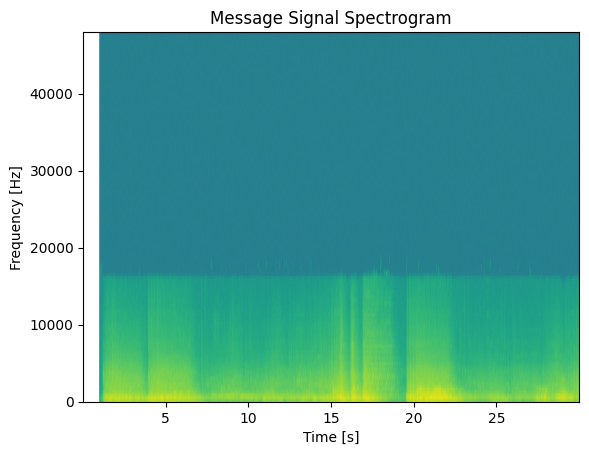

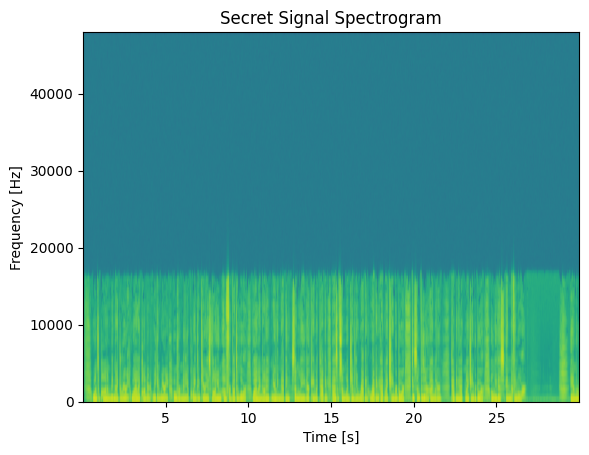

In [ ]:
message = load_audio("classical.mp3")
secret = load_audio("poem.mp3")

# Generate time values for generating signals
t = np.linspace(0, len(message) / SAMPLE_RATE, len(message))

spectrogram(message, "Message Signal Spectrogram")
spectrogram(secret, "Secret Signal Spectrogram")

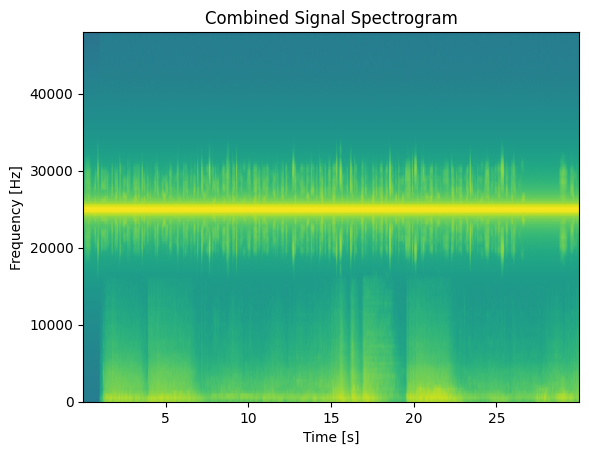

In [67]:
# https://en.wikipedia.org/wiki/Amplitude_modulation
# Amplitude Modulation (AM) is a technique used to encode information into waves,
# usually radio waves but in this case ultrasound waves.
def am_modulate(data, carrier_freq):
    # AM radio uses a 10kHz bandwidth, so we must remove any information outside of that range
    # with a bandpass filter.
    bandpass = signal.butter(10, (carrier_freq - 5000, carrier_freq + 5000), btype='bandpass', fs=SAMPLE_RATE, output='sos')

    # Give the carrier a high amplitude for a high signal to noise ratio.
    # This allows us to recover the signal more accurately and with higher quality later.
    # Amplitude sensitivity controls how much the carrier amplitude varies with the signal.
    # Since we normalize the signal it is easy to experiment with. Values over 1 cause
    # overmodulation, which introduces distortion.
    carrier_amplitude = 32000
    amplitude_sensitivity = 1

    # Normalize signal to -1 to 1 range, preventing audio clipping.
    # Clipping introduces unwanted high frequency artifacts.
    # https://en.wikipedia.org/wiki/Clipping_(signal_processing)
    n = data / np.max(np.abs(data))

    # Generate the modulated signal
    carrier = carrier_amplitude * np.sin(2 * np.pi * carrier_freq * t)
    modulated_signal = (1 + amplitude_sensitivity * n[:len(t)]) * carrier
    modulated_signal = signal.sosfilt(bandpass, modulated_signal)
    return modulated_signal

# The secret message is modulated onto a 25kHz carrier wave,
# which is outside of the human hearing range.
modulated_secret = am_modulate(secret, carrier_freq=25000)
out_signal = message + modulated_secret

# If we listen to the combined signal, we should only hear the message audio, but
# the secret audio is still there, hidden in high frequencies we cannot hear.

spectrogram(out_signal, "Combined Signal Spectrogram")

In [68]:
IPython.display.Audio(data=out_signal, rate=SAMPLE_RATE)

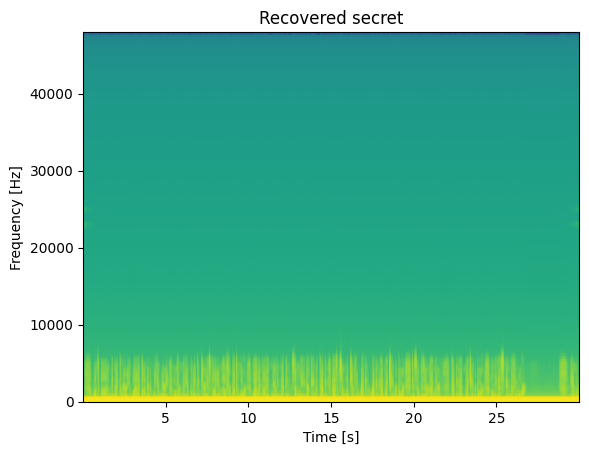

In [78]:
# Recover the signal by demodulating the AM signal.
def am_demodulate(data, carrier_freq):
    # Use a bandpass filter to select only the modulated signal
    filt = signal.butter(10, (carrier_freq - 5000, carrier_freq + 5000), btype='bandpass', fs=SAMPLE_RATE, output='sos')
    filtered = signal.sosfilt(filt, data)
    # Use the Hilbert transform to recover the amplitude envelope of the signal
    # https://dsp.stackexchange.com/questions/25845/meaning-of-hilbert-transform
    # https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.hilbert.html
    filtered = np.abs(signal.hilbert(filtered))
    return filtered

recovered_secret = am_demodulate(out_signal, carrier_freq=25000)
spectrogram(recovered_secret, "Recovered secret")

In [ ]:
# Listen to the recovered secret audio
IPython.display.Audio(recovered_secret, rate=SAMPLE_RATE)

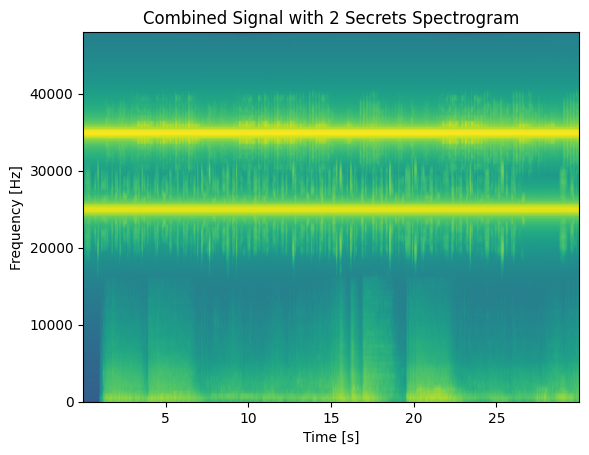

In [ ]:
# We can even add multiple secret messages by modulating them onto different carrier frequencies.
# This is similar to how multiple radio stations can broadcast on different frequencies.

secret2 = load_audio("mozart.mp3")
modulated_secret2 = am_modulate(secret2, carrier_freq=35000)

out_signal += modulated_secret2

spectrogram(out_signal, "Combined Signal with 2 Secrets Spectrogram")

In [84]:
# Listen to the 2nd recovered secret audio
IPython.display.Audio(am_demodulate(out_signal, carrier_freq=35000), rate=SAMPLE_RATE)